In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

import tensorflow as tf
from tensorflow.keras import backend as keras_backend
import numpy as np

gpu_on = True

if gpu_on :
    gpu_devices = tf.config.experimental.list_physical_devices("GPU")
    for device in gpu_devices:
        tf.config.experimental.set_memory_growth(device, True)
else:
    os.environ['CUDA_VISIBLE_DEVICES'] = '-1'
    gpu_devices = tf.config.experimental.list_physical_devices("CPU")

print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
from src.data_loader.cycle_gan import CycleGanDataloader
from tensorflow.keras.applications.inception_v3 import preprocess_input
from glob import glob

task = "cycle_gan"
data_set_name = "HE_IHC_dataset"
batch_size = 4
on_memory = False
argumentation_proba = 0
target_size = (256, 256)
interpolation = "bilinear"
class_mode = "binary"
# class_mode = "categorical"
dtype="float32"

train_image_path_list = glob(f"./datasets/{task}/{data_set_name}/HE/train/*/*")
train_target_image_path_list = glob(f"./datasets/{task}/{data_set_name}/IHC/train/*/*")
test_image_path_list = glob(f"./datasets/{task}/{data_set_name}/HE/test/*/*")
test_target_image_path_list = glob(f"./datasets/{task}/{data_set_name}/IHC/test/*/*")

train_data_loader = CycleGanDataloader(image_path_list=train_image_path_list,
                                       target_image_path_list=train_target_image_path_list,
                                       batch_size=batch_size,
                                       on_memory=on_memory,
                                       argumentation_proba=argumentation_proba,
                                       preprocess_input=preprocess_input,
                                       target_size=target_size,
                                       interpolation=interpolation,
                                       shuffle=True,
                                       dtype=dtype
)
test_data_loader = CycleGanDataloader(image_path_list=test_image_path_list,
                                      target_image_path_list=test_target_image_path_list,
                                       batch_size=1,
                                       on_memory=False,
                                       argumentation_proba=0,
                                       preprocess_input=preprocess_input,
                                       target_size=target_size,
                                       interpolation=interpolation,                                       
                                       shuffle=False,
                                       dtype=dtype
)

Source data num 11000, Target data num: 11000
Source data num 3000, Target data num: 3000


In [3]:
from copy import deepcopy

from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.losses import Huber
from tensorflow.keras.optimizers import Nadam
from tensorflow.keras.metrics import Accuracy
from tensorflow.keras.activations import sigmoid
from tensorflow.image import ssim
import segmentation_models as sm
from tensorflow.keras.applications import InceptionV3

from src.model.build_model import build_generator, build_discriminator
from src.util.custom_loss import dice_score
from src.util.loss_cycle_gan import get_channel_weighted_dice_loss, get_channel_weighted_mse_loss
from src.model.cycle_gan import CycleGan

BACKBONE="inceptionv3"
optimizer = Nadam(2e-4, beta_1=0.5, clipnorm=1)
input_image_shape = (*target_size, 3)
output_image_shape = (*target_size, 3)

cycle_gan_model = CycleGan()

cycle_gan_model.compile(
    generator_G_optimizer=optimizer,
    generator_F_optimizer=optimizer,
    discriminator_X_optimizer=optimizer,
    discriminator_Y_optimizer=optimizer,
)


Segmentation Models: using `keras` framework.


In [4]:
from tensorflow.keras.callbacks import Callback, ModelCheckpoint
from tensorflow.keras.callbacks import ReduceLROnPlateau, LearningRateScheduler
from tensorflow.keras.preprocessing import image
from matplotlib import pyplot as plt

class GANMonitor(Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, data_loader, save_image_path, num_img=4):
        self.data_loader = data_loader
        self.num_img = num_img
        self.save_image_path = save_image_path
        
        os.makedirs(save_image_path, exist_ok=True)
        
    def on_epoch_end(self, epoch, logs=None):
        
        len_data_loader = len(self.data_loader)
        random_index = range(len_data_loader)
        random_index = np.random.permutation(random_index)[:self.num_img]
        
        _, ax = plt.subplots(self.num_img, 4, figsize=(12, 12))
        for current_index, image_index in enumerate(random_index):
            image_array, target_image_array = self.data_loader[image_index]
            iamge_array_name = self.data_loader.data_getter.target_image_path_dict[image_index]
            prediction = self.model.generator_G(image_array).numpy()[0]
            reverse_prediction = self.model.generator_F(target_image_array).numpy()[0]
            
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            reverse_prediction = (reverse_prediction * 127.5 + 127.5).astype(np.uint8)
            
            image_array = (image_array[0] * 127.5 + 127.5).astype(np.uint8)
            target_image_array = (target_image_array[0] * 127.5 + 127.5).astype(np.uint8)
            
            ax[current_index, 0].imshow(image_array)
            ax[current_index, 1].imshow(prediction)
            ax[current_index, 0].set_title("Input image_x")
            ax[current_index, 1].set_title("Translated image_y")
#             ax[current_index, 0].axis("off")
#             ax[current_index, 1].axis("off")

            ax[current_index, 2].imshow(target_image_array)
            ax[current_index, 3].imshow(reverse_prediction)
            ax[current_index, 2].set_title("Input image_y")
            ax[current_index, 3].set_title("Translated image_x")
#             ax[current_index, 0].axis("off")
#             ax[current_index, 1].axis("off")

            prediction = image.array_to_img(prediction)
            reverse_prediction = image.array_to_img(reverse_prediction)
        plt.savefig(f"{self.save_image_path}/generated_image_{epoch+1}")
        plt.show()
        plt.close()
        
class ModelCheckpointWithWeight(ModelCheckpoint):
    """A callback to generate and save images after each epoch"""

    def __init__(self, *args, **kwargs):
        super(ModelCheckpointWithWeight, self).__init__(*args, **kwargs)

    def on_epoch_end(self, epoch, logs=None):
        super(ModelCheckpointWithWeight, self).on_epoch_end(epoch, logs=logs)
        save_folder = self.filepath.format(epoch=epoch+1)
        
        self.model.generator_G.save_weights(f"{save_folder}/generator_G.hdf5")
        self.model.generator_F.save_weights(f"{save_folder}/generator_F.hdf5")
        self.model.discriminator_X.save_weights(f"{save_folder}/discriminator_X.hdf5")
        self.model.discriminator_Y.save_weights(f"{save_folder}/discriminator_Y.hdf5")

class TurnOffIdentitiyLoss(Callback):
    def __init__(self, target_epoch=5):
        self.target_epoch = target_epoch
    def on_epoch_end(self, epoch, logs=None):
        epoch = epoch + 1
        print(f"is current identity loss turn on: {self.model.turn_on_identity_loss}")
        if epoch >= self.target_epoch:
            self.model.turn_on_identity_loss = False

def decay_learning_rate_scheduler(
    epoch, learning_rate, decay_epoch=10, decay_rate=0.8
):
    if epoch > 0 and epoch < decay_epoch:
        learning_rate = learning_rate * decay_rate
    
    return learning_rate

decay_up_lr_scheduler = LearningRateScheduler(decay_learning_rate_scheduler, verbose=1)


In [5]:
save_image_path = f"./images/{task}/{data_set_name}/{target_size}/"
checkpoint_folder = f"./weights/{task}/{data_set_name}/{target_size}/"
os.makedirs(checkpoint_folder, exist_ok=True)

plotter = GANMonitor(data_loader=test_data_loader, save_image_path=save_image_path, num_img=4)
checkpoint_filepath = checkpoint_folder + "/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = ModelCheckpointWithWeight(
    filepath=checkpoint_filepath
)

reduceLROnPlat = ReduceLROnPlateau(
    monitor="cycle_loss_F",
    factor=0.1,
    patience=2,
    verbose=1,
    mode="auto",
    min_delta=0.0001,
    cooldown=0,
    min_lr=1e-7)

turn_off_identity_loss_callback = TurnOffIdentitiyLoss()

Epoch 1/100
2750/2750 [==============================] - 3781s 1s/step - total_loss_G: 1.6970 - total_loss_F: 3.0665 - D_X_loss: 0.4326 - D_Y_loss: 0.4703 - generator_G_loss: 0.6367 - generator_F_loss: 0.6557 - identity_loss_G: 0.3201 - identity_loss_F: 0.6730 - cycle_loss_G: 0.7401 - cycle_loss_F: 1.7379


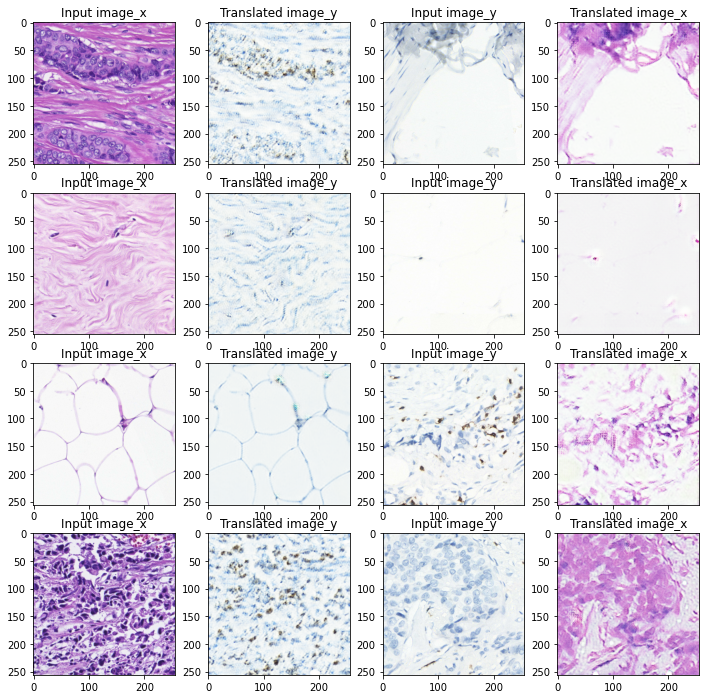

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.001\assets
Epoch 2/100
2750/2750 [==============================] - 3949s 1s/step - total_loss_G: 1.3239 - total_loss_F: 2.5632 - D_X_loss: 0.4532 - D_Y_loss: 0.4933 - generator_G_loss: 0.5497 - generator_F_loss: 0.6165 - identity_loss_G: 0.2028 - identity_loss_F: 0.5017 - cycle_loss_G: 0.5714 - cycle_loss_F: 1.4450


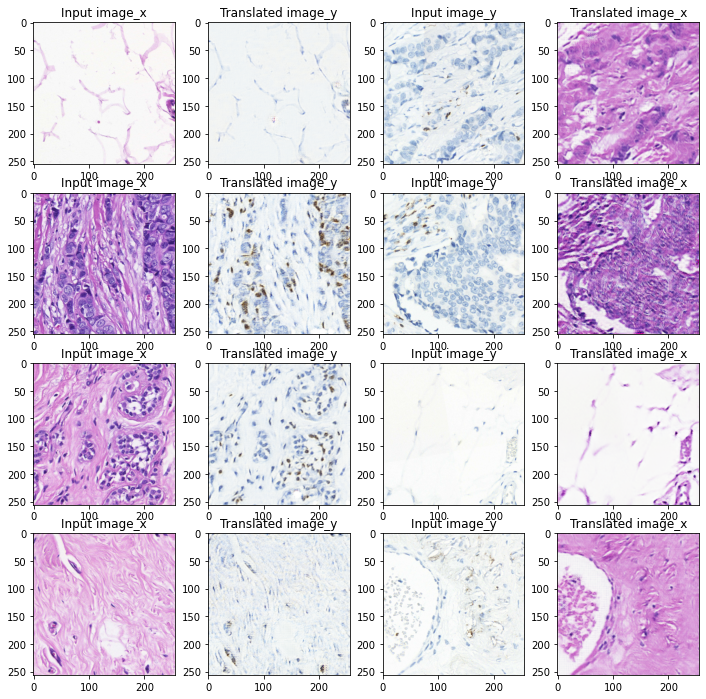

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.002\assets
Epoch 3/100
2750/2750 [==============================] - 3985s 1s/step - total_loss_G: 1.2528 - total_loss_F: 2.3463 - D_X_loss: 0.4823 - D_Y_loss: 0.4953 - generator_G_loss: 0.5430 - generator_F_loss: 0.5670 - identity_loss_G: 0.1747 - identity_loss_F: 0.4543 - cycle_loss_G: 0.5351 - cycle_loss_F: 1.3250


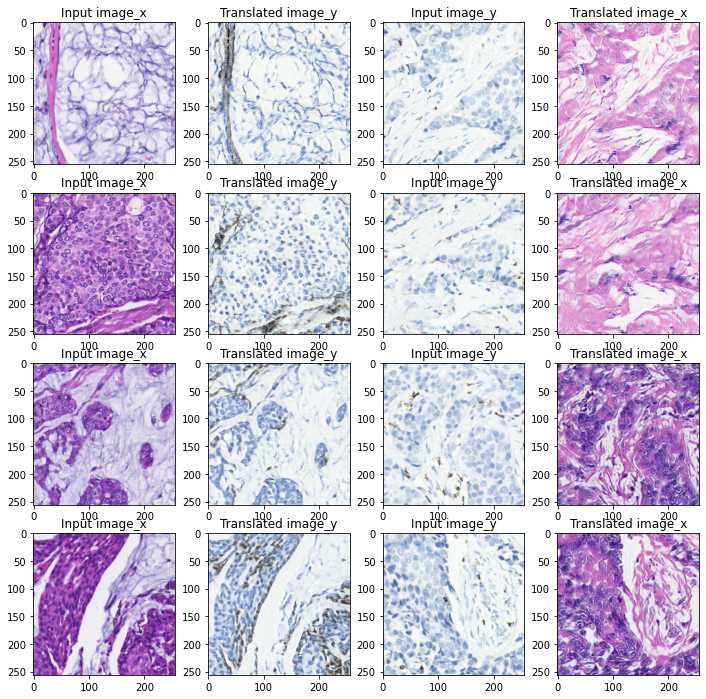

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.003\assets
Epoch 4/100
2750/2750 [==============================] - 3796s 1s/step - total_loss_G: 1.2010 - total_loss_F: 2.2714 - D_X_loss: 0.4785 - D_Y_loss: 0.4963 - generator_G_loss: 0.5483 - generator_F_loss: 0.5772 - identity_loss_G: 0.1552 - identity_loss_F: 0.4267 - cycle_loss_G: 0.4976 - cycle_loss_F: 1.2675


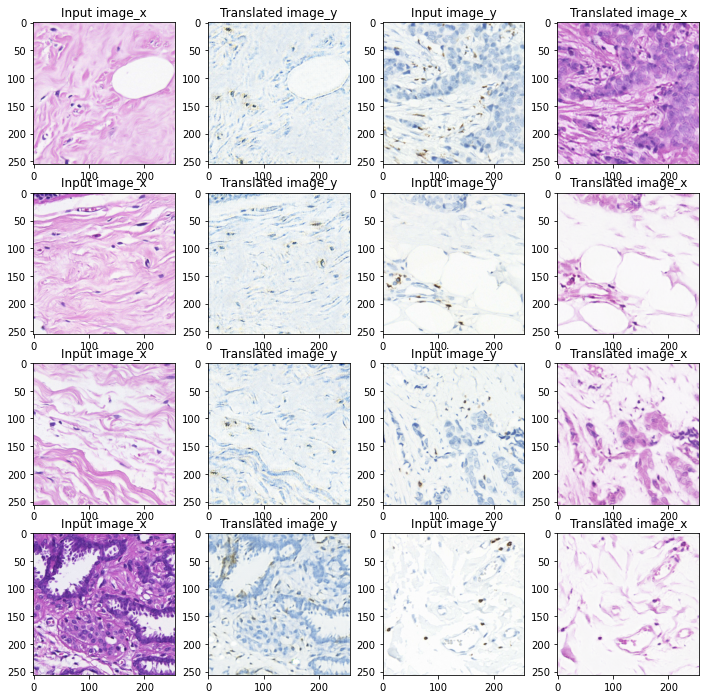

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.004\assets
Epoch 5/100
2750/2750 [==============================] - 3840s 1s/step - total_loss_G: 1.1684 - total_loss_F: 2.2782 - D_X_loss: 0.4685 - D_Y_loss: 0.4965 - generator_G_loss: 0.5452 - generator_F_loss: 0.6147 - identity_loss_G: 0.1439 - identity_loss_F: 0.4155 - cycle_loss_G: 0.4793 - cycle_loss_F: 1.2480


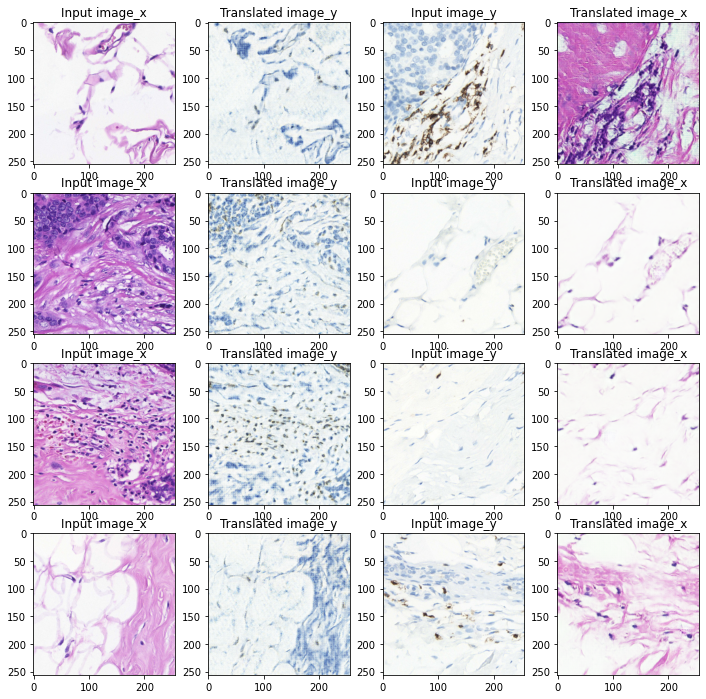

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.005\assets
Epoch 6/100
2750/2750 [==============================] - 3902s 1s/step - total_loss_G: 1.1588 - total_loss_F: 2.1498 - D_X_loss: 0.4855 - D_Y_loss: 0.4960 - generator_G_loss: 0.5529 - generator_F_loss: 0.5765 - identity_loss_G: 0.1354 - identity_loss_F: 0.3895 - cycle_loss_G: 0.4705 - cycle_loss_F: 1.1837


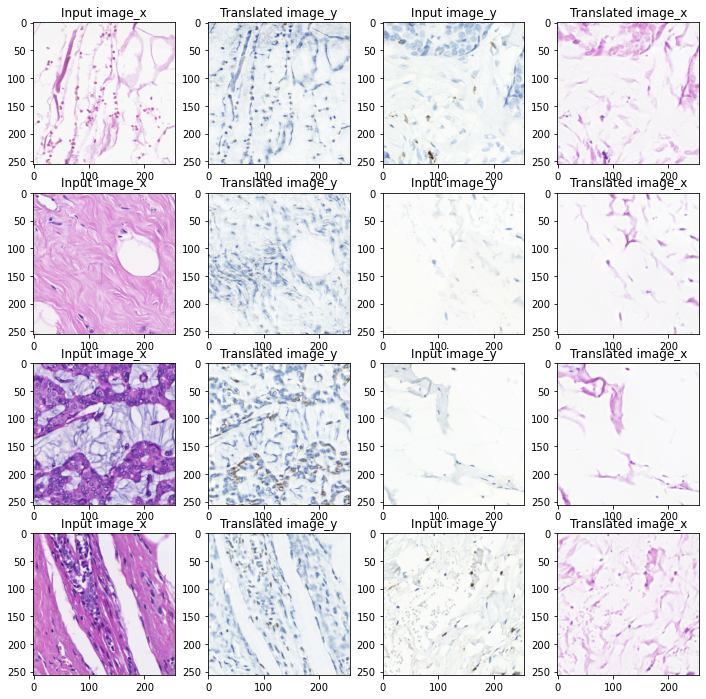

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.006\assets
Epoch 7/100
2750/2750 [==============================] - 3846s 1s/step - total_loss_G: 1.1292 - total_loss_F: 2.2054 - D_X_loss: 0.4677 - D_Y_loss: 0.4969 - generator_G_loss: 0.5536 - generator_F_loss: 0.6338 - identity_loss_G: 0.1287 - identity_loss_F: 0.3833 - cycle_loss_G: 0.4470 - cycle_loss_F: 1.1883


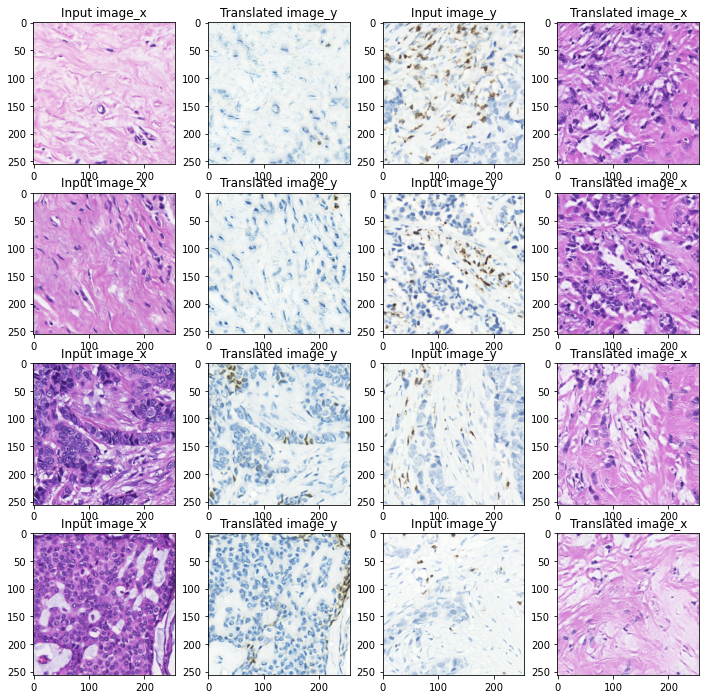

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.007\assets
Epoch 8/100
2750/2750 [==============================] - 3872s 1s/step - total_loss_G: 1.1222 - total_loss_F: 2.0963 - D_X_loss: 0.4791 - D_Y_loss: 0.4972 - generator_G_loss: 0.5545 - generator_F_loss: 0.5659 - identity_loss_G: 0.1223 - identity_loss_F: 0.3775 - cycle_loss_G: 0.4455 - cycle_loss_F: 1.1529


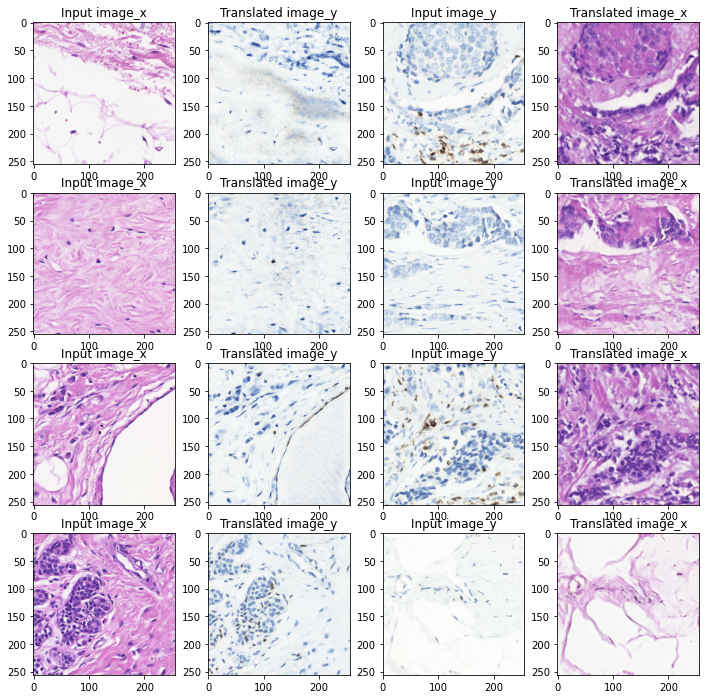

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.008\assets
Epoch 9/100
2750/2750 [==============================] - 4111s 1s/step - total_loss_G: 1.0952 - total_loss_F: 2.1286 - D_X_loss: 0.4727 - D_Y_loss: 0.4974 - generator_G_loss: 0.5454 - generator_F_loss: 0.6342 - identity_loss_G: 0.1165 - identity_loss_F: 0.3673 - cycle_loss_G: 0.4333 - cycle_loss_F: 1.1272


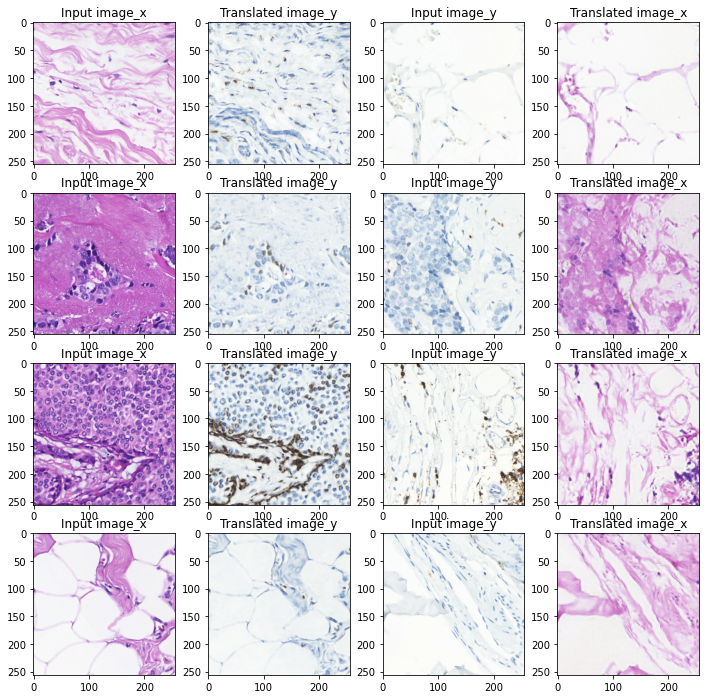

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.009\assets
Epoch 10/100
2750/2750 [==============================] - 4010s 1s/step - total_loss_G: 1.0867 - total_loss_F: 2.0478 - D_X_loss: 0.4794 - D_Y_loss: 0.4979 - generator_G_loss: 0.5528 - generator_F_loss: 0.5919 - identity_loss_G: 0.1114 - identity_loss_F: 0.3513 - cycle_loss_G: 0.4225 - cycle_loss_F: 1.1046


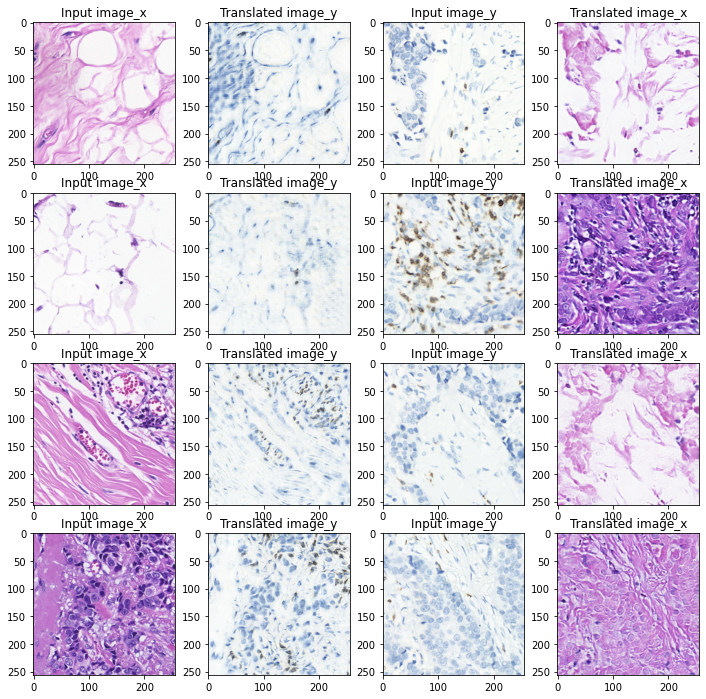

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.010\assets
Epoch 11/100
2750/2750 [==============================] - 3716s 1s/step - total_loss_G: 1.0767 - total_loss_F: 2.0616 - D_X_loss: 0.4786 - D_Y_loss: 0.4972 - generator_G_loss: 0.5431 - generator_F_loss: 0.6225 - identity_loss_G: 0.1083 - identity_loss_F: 0.3473 - cycle_loss_G: 0.4253 - cycle_loss_F: 1.0918


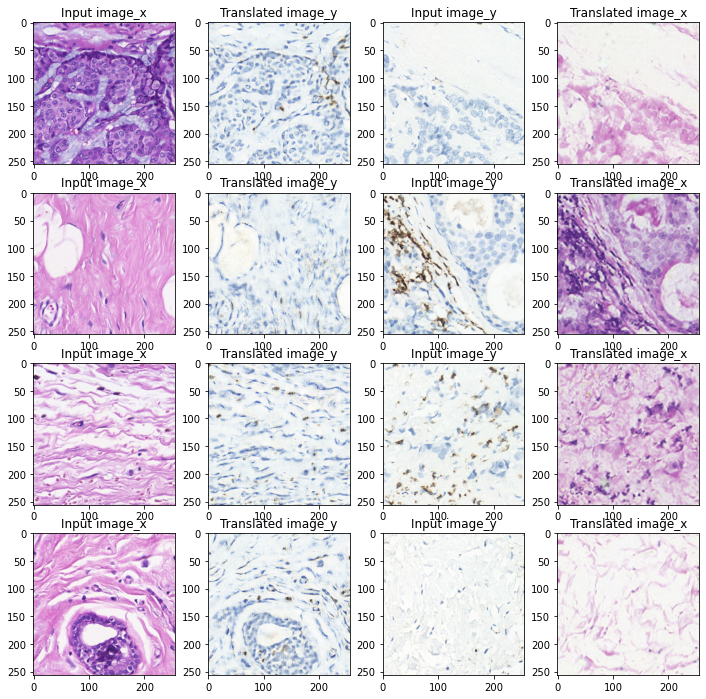

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.011\assets
Epoch 12/100
2750/2750 [==============================] - 3709s 1s/step - total_loss_G: 1.0798 - total_loss_F: 2.0526 - D_X_loss: 0.4848 - D_Y_loss: 0.4974 - generator_G_loss: 0.5479 - generator_F_loss: 0.5968 - identity_loss_G: 0.1039 - identity_loss_F: 0.3504 - cycle_loss_G: 0.4280 - cycle_loss_F: 1.1053


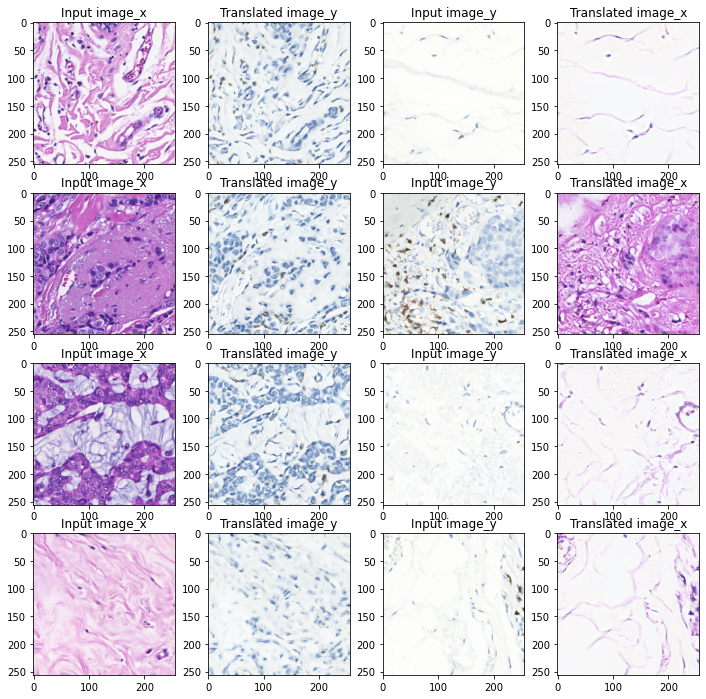

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.012\assets
Epoch 13/100
2750/2750 [==============================] - 3673s 1s/step - total_loss_G: 1.0699 - total_loss_F: 1.9679 - D_X_loss: 0.4894 - D_Y_loss: 0.4973 - generator_G_loss: 0.5496 - generator_F_loss: 0.5758 - identity_loss_G: 0.1016 - identity_loss_F: 0.3311 - cycle_loss_G: 0.4187 - cycle_loss_F: 1.0610


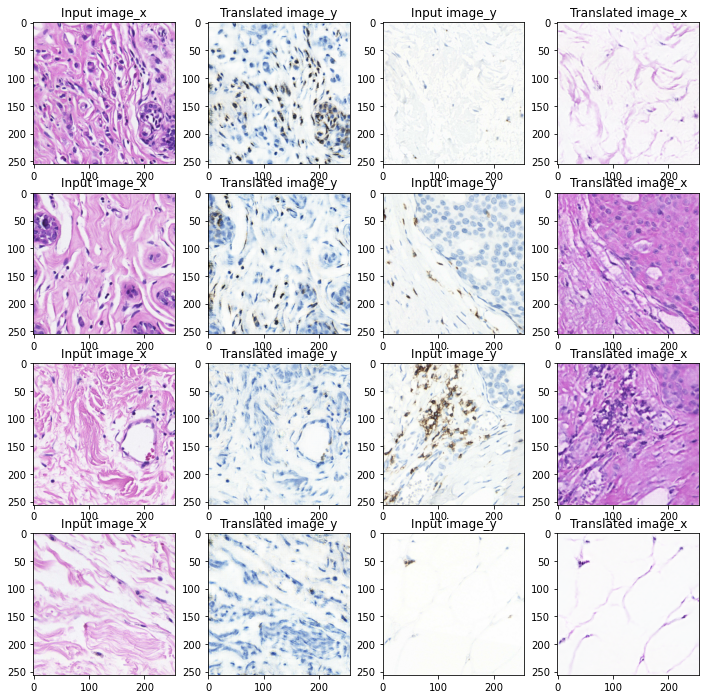

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.013\assets
Epoch 14/100
2750/2750 [==============================] - 3674s 1s/step - total_loss_G: 1.0431 - total_loss_F: 2.0217 - D_X_loss: 0.4837 - D_Y_loss: 0.4977 - generator_G_loss: 0.5377 - generator_F_loss: 0.5995 - identity_loss_G: 0.0993 - identity_loss_F: 0.3384 - cycle_loss_G: 0.4061 - cycle_loss_F: 1.0838


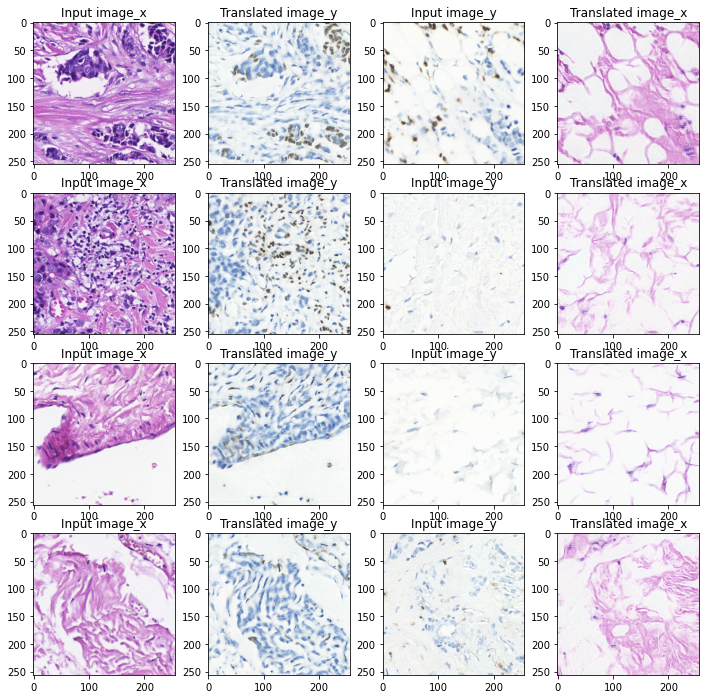

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.014\assets
Epoch 15/100
2750/2750 [==============================] - 3673s 1s/step - total_loss_G: 1.0582 - total_loss_F: 1.9596 - D_X_loss: 0.4885 - D_Y_loss: 0.4969 - generator_G_loss: 0.5475 - generator_F_loss: 0.5666 - identity_loss_G: 0.0977 - identity_loss_F: 0.3294 - cycle_loss_G: 0.4130 - cycle_loss_F: 1.0637


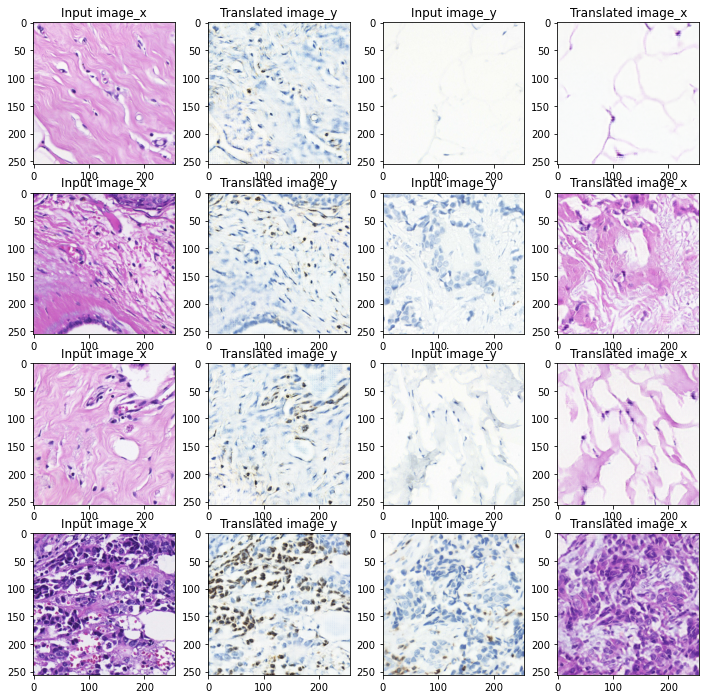

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.015\assets
Epoch 16/100
2750/2750 [==============================] - 3672s 1s/step - total_loss_G: 1.0531 - total_loss_F: 1.9708 - D_X_loss: 0.4861 - D_Y_loss: 0.4966 - generator_G_loss: 0.5461 - generator_F_loss: 0.5885 - identity_loss_G: 0.0967 - identity_loss_F: 0.3271 - cycle_loss_G: 0.4102 - cycle_loss_F: 1.0551


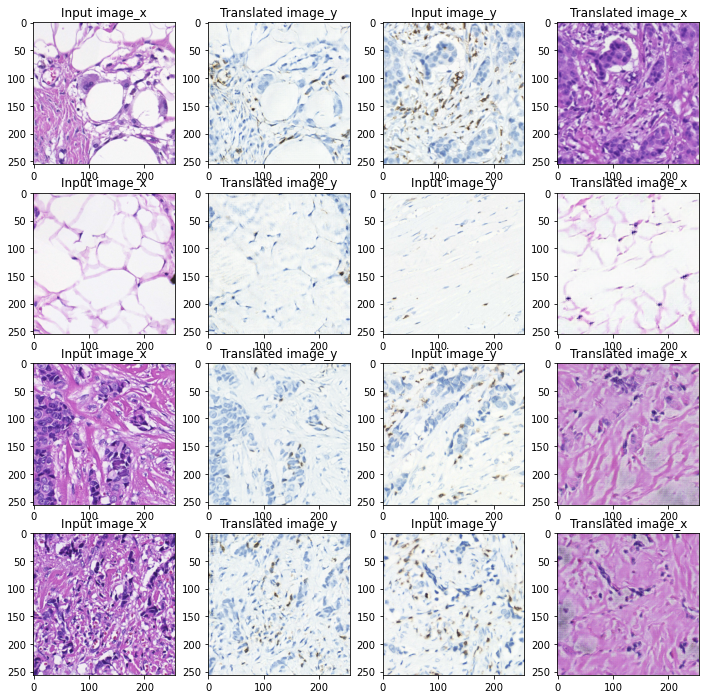

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.016\assets
Epoch 17/100
2750/2750 [==============================] - 3672s 1s/step - total_loss_G: 1.0311 - total_loss_F: 1.9385 - D_X_loss: 0.4897 - D_Y_loss: 0.4964 - generator_G_loss: 0.5347 - generator_F_loss: 0.5700 - identity_loss_G: 0.0949 - identity_loss_F: 0.3205 - cycle_loss_G: 0.4015 - cycle_loss_F: 1.0480


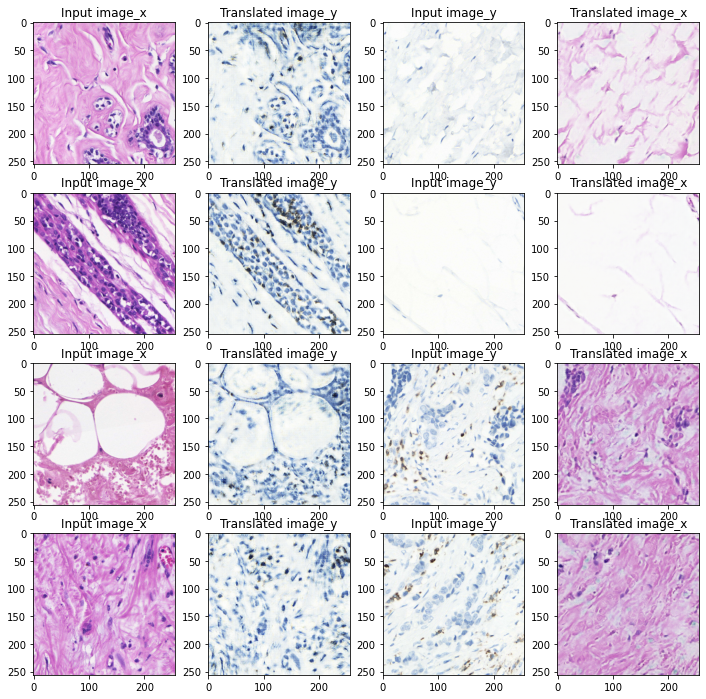

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.017\assets
Epoch 18/100
2750/2750 [==============================] - 3696s 1s/step - total_loss_G: 1.0498 - total_loss_F: 1.9385 - D_X_loss: 0.4879 - D_Y_loss: 0.4957 - generator_G_loss: 0.5401 - generator_F_loss: 0.5766 - identity_loss_G: 0.0942 - identity_loss_F: 0.3165 - cycle_loss_G: 0.4155 - cycle_loss_F: 1.0454


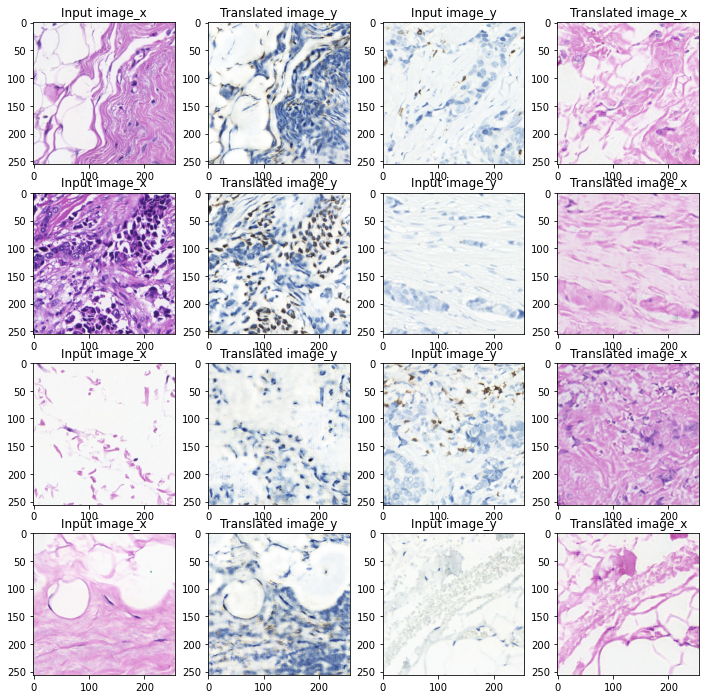

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.018\assets
Epoch 19/100
2750/2750 [==============================] - 3747s 1s/step - total_loss_G: 1.0440 - total_loss_F: 1.9505 - D_X_loss: 0.4863 - D_Y_loss: 0.4947 - generator_G_loss: 0.5432 - generator_F_loss: 0.5853 - identity_loss_G: 0.0929 - identity_loss_F: 0.3192 - cycle_loss_G: 0.4078 - cycle_loss_F: 1.0460


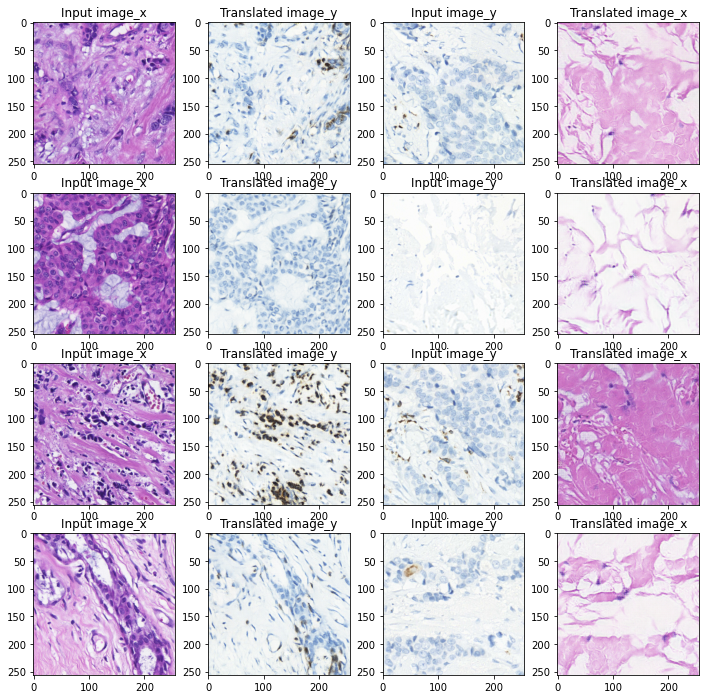

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.019\assets
Epoch 20/100
   8/2750 [..............................] - ETA: 1:06:12 - total_loss_G: 1.1387 - total_loss_F: 2.0476 - D_X_loss: 0.4915 - D_Y_loss: 0.4850 - generator_G_loss: 0.4882 - generator_F_loss: 0.4882 - identity_loss_G: 0.1046 - identity_loss_F: 0.3307 - cycle_loss_G: 0.5460 - cycle_loss_F: 1.2287

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "C:\Users\gr300\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3437, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-6-006187fe99c0>", line 1, in <module>
    cycle_gan_model.fit(
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\engine\training.py", line 1183, in fit
    tmp_logs = self.train_function(iterator)
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\eager\def_function.py", line 889, in __call__
    result = self._call(*args, **kwds)
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\eager\def_function.py", line 917, in _call
    return self._stateless_fn(*args, **kwds)  # pylint: disable=not-callable
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\eager\function.py", line 3023, in __call__
    return graph_function._call_flat(
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\py

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "C:\Users\gr300\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3437, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-6-006187fe99c0>", line 1, in <module>
    cycle_gan_model.fit(
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\engine\training.py", line 1183, in fit
    tmp_logs = self.train_function(iterator)
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\eager\def_function.py", line 889, in __call__
    result = self._call(*args, **kwds)
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\eager\def_function.py", line 917, in _call
    return self._stateless_fn(*args, **kwds)  # pylint: disable=not-callable
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\eager\function.py", line 3023, in __call__
    return graph_function._call_flat(
  File "C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\py

TypeError: object of type 'NoneType' has no len()

In [5]:
cycle_gan_model.fit(
    train_data_loader,
    epochs=20,
    callbacks=[plotter, model_checkpoint_callback],
)

Epoch 25/100

Epoch 00025: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2671s 954ms/step - total_loss_G: 0.9640 - total_loss_F: 1.6668 - D_X_loss: 0.4725 - D_Y_loss: 0.4862 - generator_G_loss: 0.5469 - generator_F_loss: 0.6046 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4170 - cycle_loss_F: 1.0623


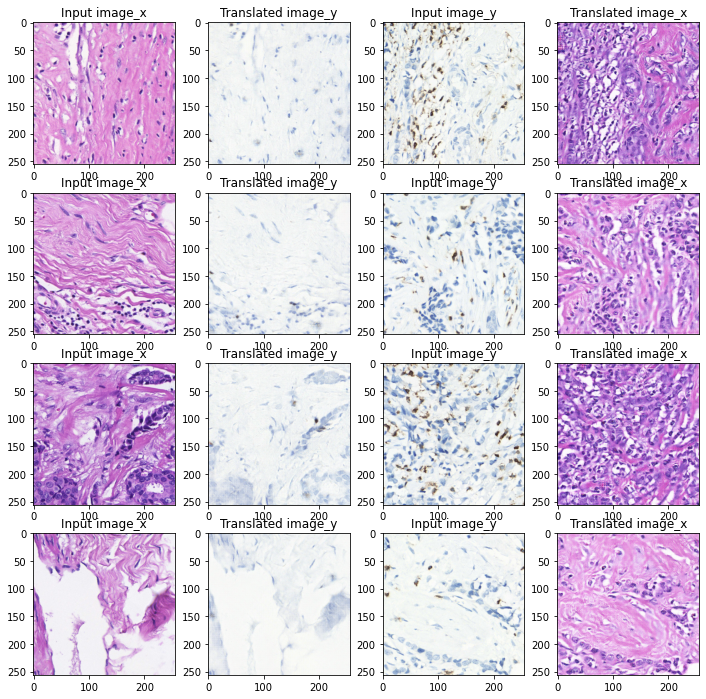

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.025\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.025\assets


Epoch 26/100

Epoch 00026: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2685s 976ms/step - total_loss_G: 0.9543 - total_loss_F: 1.6540 - D_X_loss: 0.4709 - D_Y_loss: 0.4803 - generator_G_loss: 0.5431 - generator_F_loss: 0.6102 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4112 - cycle_loss_F: 1.0439


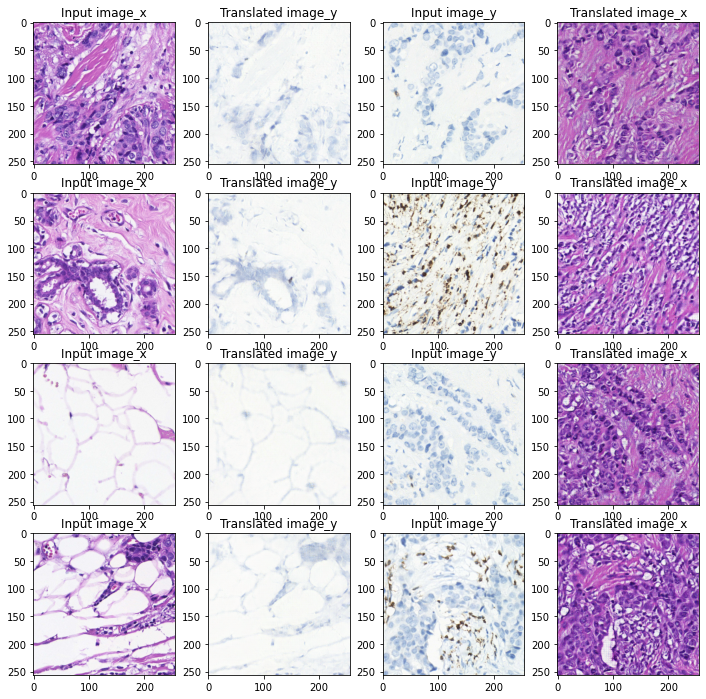

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.026\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.026\assets


Epoch 27/100

Epoch 00027: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2730s 993ms/step - total_loss_G: 0.9665 - total_loss_F: 1.6727 - D_X_loss: 0.4632 - D_Y_loss: 0.4800 - generator_G_loss: 0.5507 - generator_F_loss: 0.6339 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4158 - cycle_loss_F: 1.0388


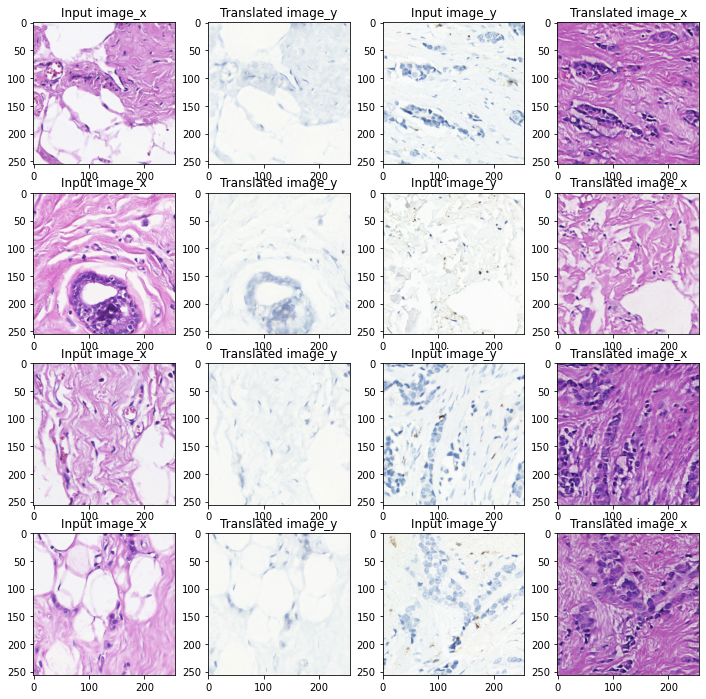

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.027\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.027\assets


Epoch 28/100

Epoch 00028: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2687s 977ms/step - total_loss_G: 0.9504 - total_loss_F: 1.6588 - D_X_loss: 0.4664 - D_Y_loss: 0.4807 - generator_G_loss: 0.5453 - generator_F_loss: 0.6386 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4051 - cycle_loss_F: 1.0201


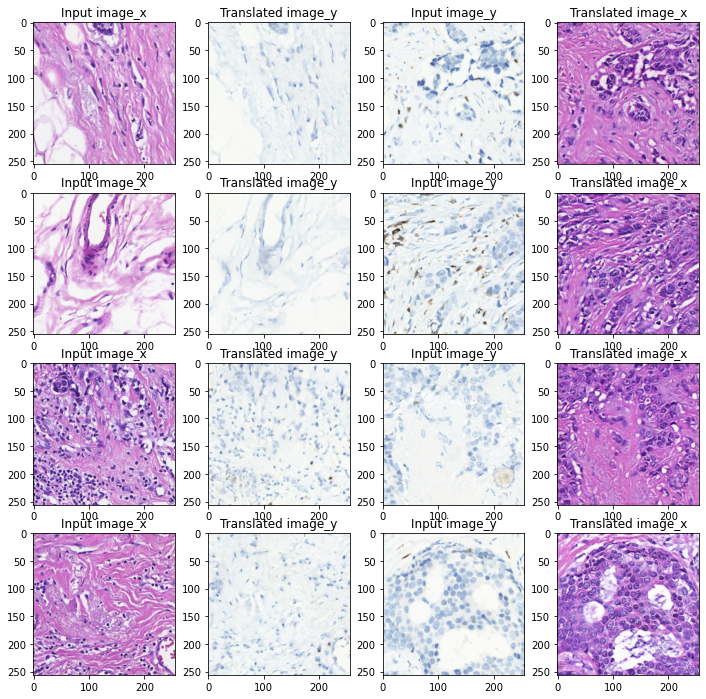

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.028\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.028\assets


Epoch 29/100

Epoch 00029: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2737s 995ms/step - total_loss_G: 0.9448 - total_loss_F: 1.6682 - D_X_loss: 0.4669 - D_Y_loss: 0.4796 - generator_G_loss: 0.5545 - generator_F_loss: 0.6363 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.3903 - cycle_loss_F: 1.0319


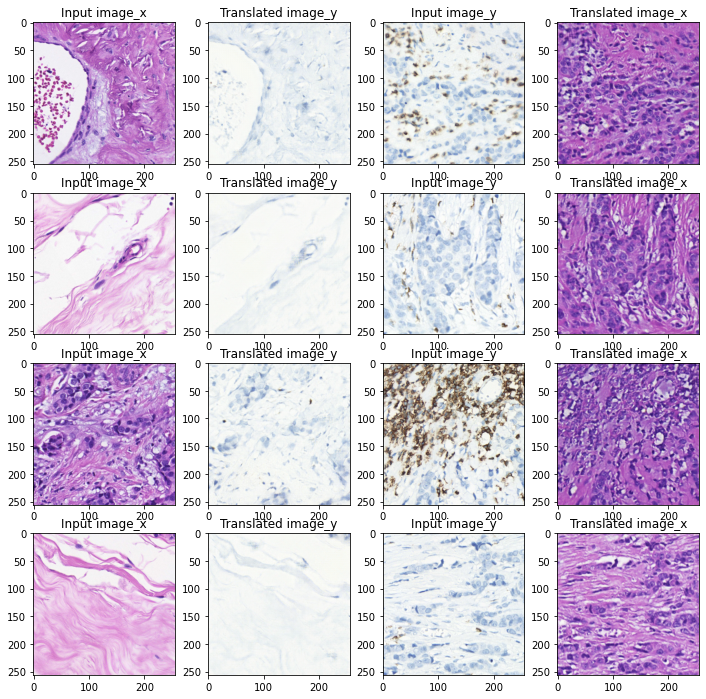

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.029\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.029\assets


Epoch 30/100

Epoch 00030: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2722s 990ms/step - total_loss_G: 0.9555 - total_loss_F: 1.6686 - D_X_loss: 0.4635 - D_Y_loss: 0.4809 - generator_G_loss: 0.5568 - generator_F_loss: 0.6362 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.3987 - cycle_loss_F: 1.0323


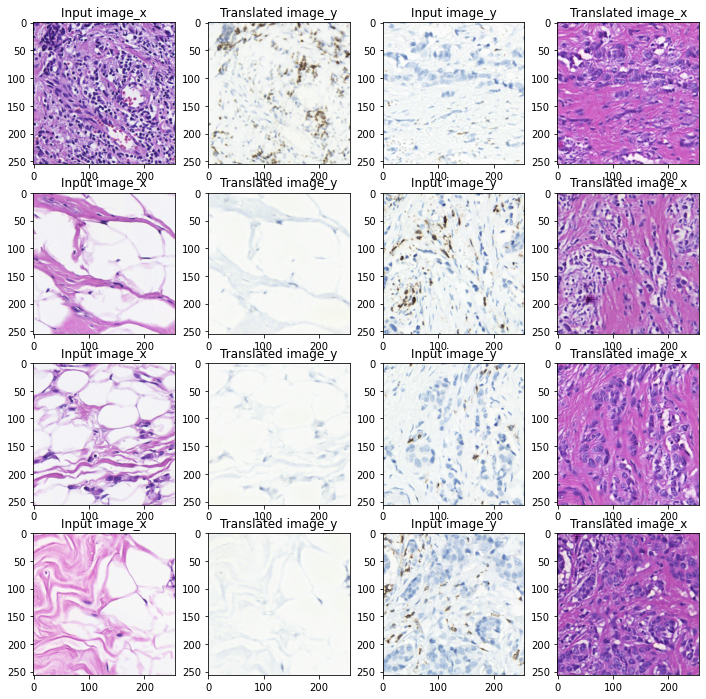

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.030\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.030\assets


Epoch 31/100

Epoch 00031: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2805s 1s/step - total_loss_G: 0.9529 - total_loss_F: 1.6537 - D_X_loss: 0.4692 - D_Y_loss: 0.4803 - generator_G_loss: 0.5507 - generator_F_loss: 0.6135 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4021 - cycle_loss_F: 1.0402


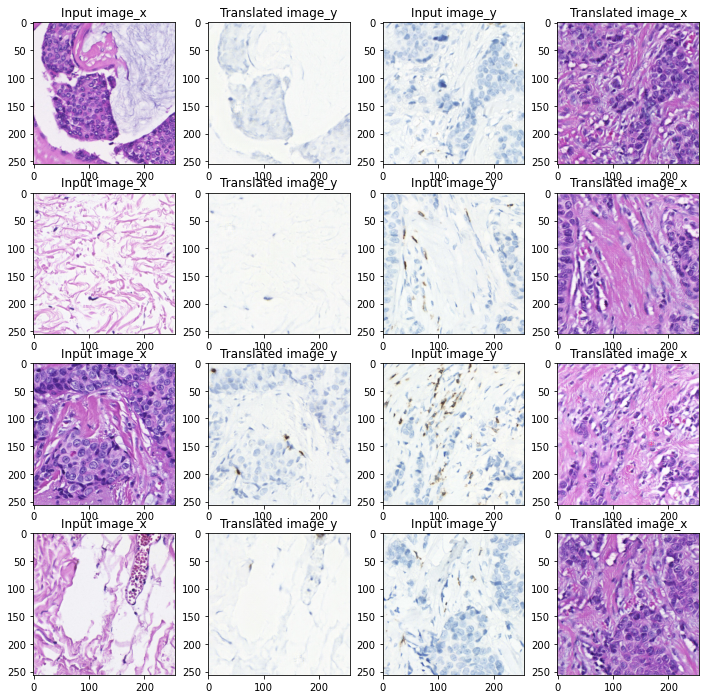

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.031\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.031\assets


Epoch 32/100

Epoch 00032: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2916s 1s/step - total_loss_G: 0.9405 - total_loss_F: 1.6599 - D_X_loss: 0.4683 - D_Y_loss: 0.4812 - generator_G_loss: 0.5418 - generator_F_loss: 0.6286 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.3987 - cycle_loss_F: 1.0314


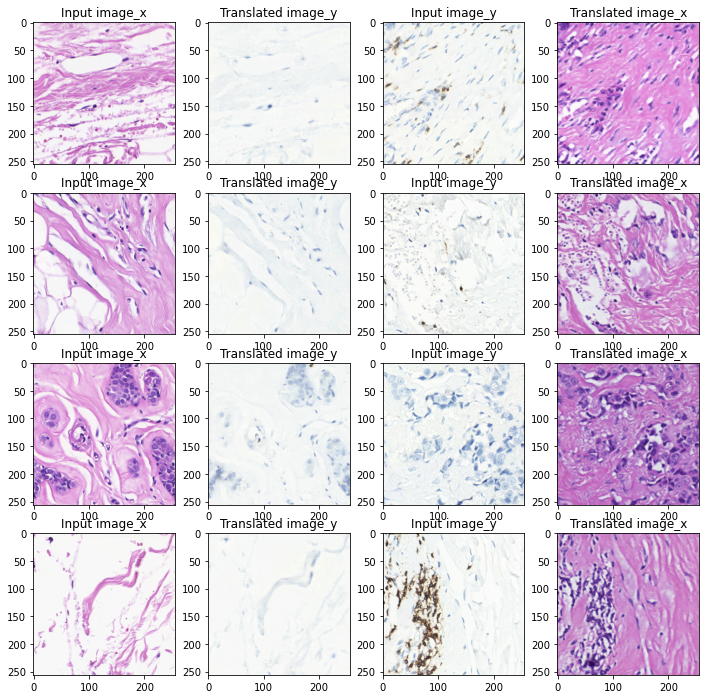

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.032\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.032\assets


Epoch 33/100

Epoch 00033: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2834s 1s/step - total_loss_G: 0.9503 - total_loss_F: 1.6692 - D_X_loss: 0.4690 - D_Y_loss: 0.4787 - generator_G_loss: 0.5500 - generator_F_loss: 0.6194 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4003 - cycle_loss_F: 1.0497


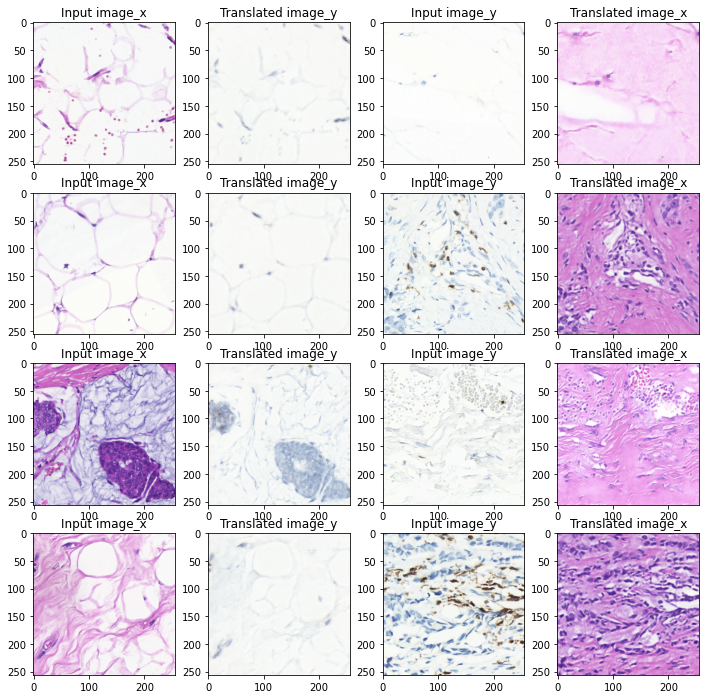

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.033\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.033\assets


Epoch 34/100

Epoch 00034: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2735s 995ms/step - total_loss_G: 0.9616 - total_loss_F: 1.6634 - D_X_loss: 0.4661 - D_Y_loss: 0.4770 - generator_G_loss: 0.5499 - generator_F_loss: 0.6096 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4117 - cycle_loss_F: 1.0538


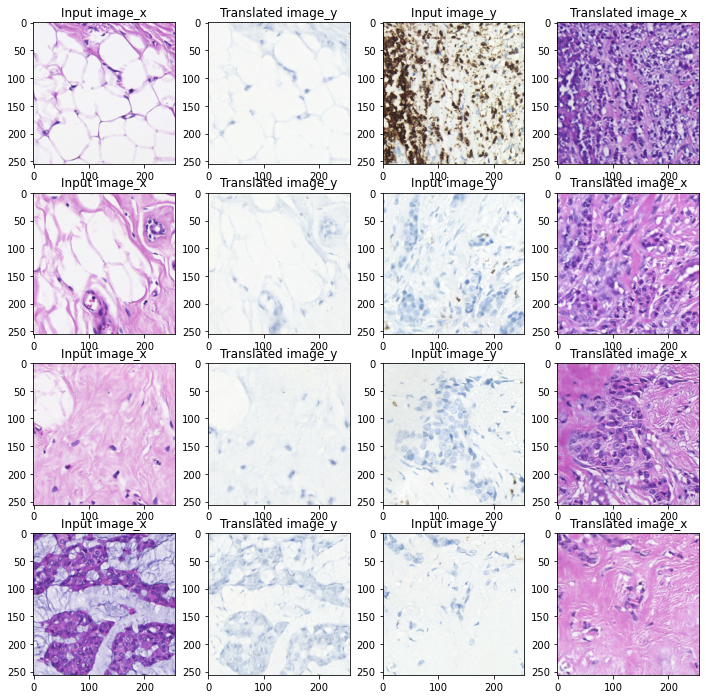

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.034\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.034\assets


Epoch 35/100

Epoch 00035: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2866s 1s/step - total_loss_G: 0.9446 - total_loss_F: 1.6286 - D_X_loss: 0.4744 - D_Y_loss: 0.4810 - generator_G_loss: 0.5381 - generator_F_loss: 0.5837 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4065 - cycle_loss_F: 1.0449


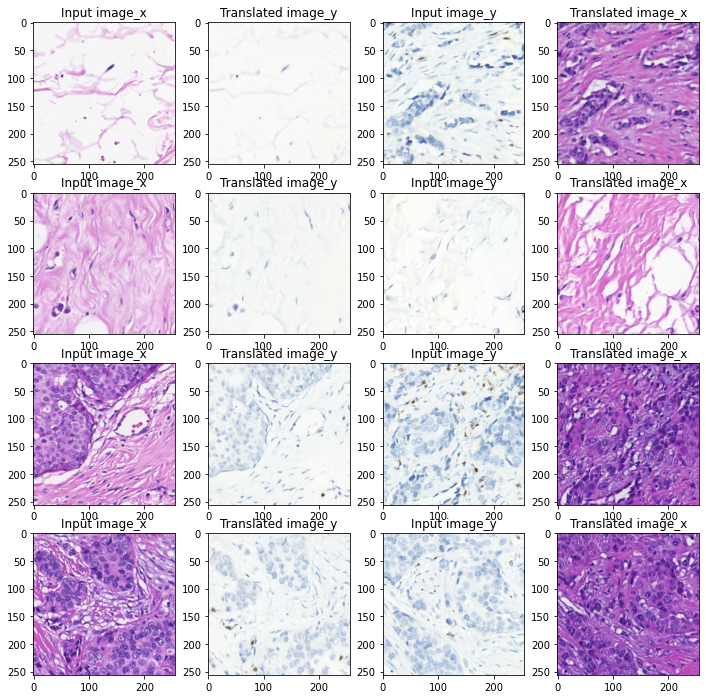

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.035\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.035\assets


Epoch 36/100

Epoch 00036: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
2750/2750 [==============================] - 2759s 1s/step - total_loss_G: 0.9624 - total_loss_F: 1.6497 - D_X_loss: 0.4720 - D_Y_loss: 0.4780 - generator_G_loss: 0.5504 - generator_F_loss: 0.5978 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4120 - cycle_loss_F: 1.0519


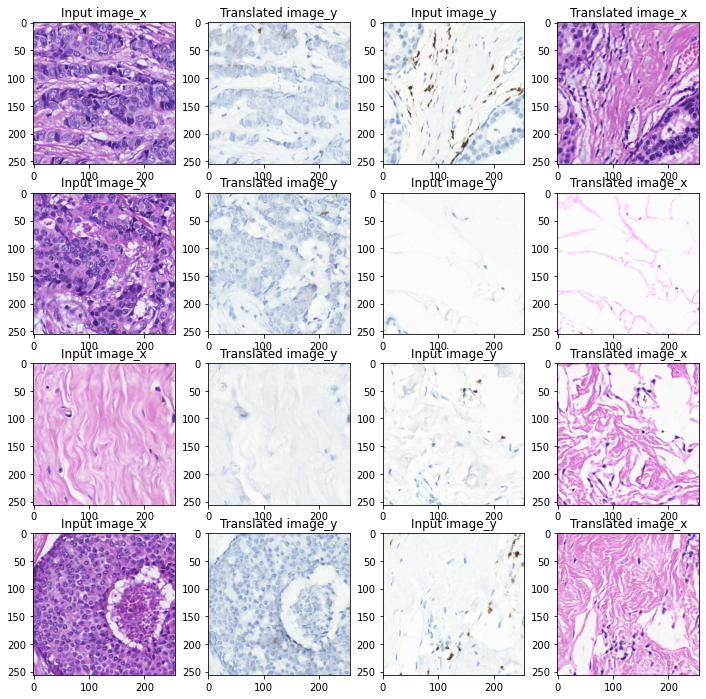

C:\Users\gr300\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.036\assets


INFO:tensorflow:Assets written to: ./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.036\assets


Epoch 37/100

Epoch 00037: LearningRateScheduler reducing learning rate to 0.0010000000474974513.
 204/2750 [=>............................] - ETA: 46:43 - total_loss_G: 0.9854 - total_loss_F: 1.5936 - D_X_loss: 0.4862 - D_Y_loss: 0.4684 - generator_G_loss: 0.5429 - generator_F_loss: 0.5556 - identity_loss_G: 0.0000e+00 - identity_loss_F: 0.0000e+00 - cycle_loss_G: 0.4425 - cycle_loss_F: 1.0380

KeyboardInterrupt: 

In [14]:
load_index = 24

common_path = f"./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.0{load_index}"

cycle_gan_model = CycleGan()

cycle_gan_model.turn_on_identity_loss = False

cycle_gan_model.generator_G.load_weights(f"{common_path}/generator_G.hdf5")
cycle_gan_model.generator_F.load_weights(f"{common_path}/generator_F.hdf5")
cycle_gan_model.discriminator_X.load_weights(f"{common_path}/discriminator_X.hdf5")
cycle_gan_model.discriminator_Y.load_weights(f"{common_path}/discriminator_Y.hdf5")

optimizer = Nadam(1e-5, beta_1=0.5, clipnorm=1)

cycle_gan_model.compile(
    generator_G_optimizer=optimizer,
    generator_F_optimizer=optimizer,
    discriminator_X_optimizer=optimizer,
    discriminator_Y_optimizer=optimizer,
)

cycle_gan_model.fit(
    train_data_loader,
    epochs=100,
    callbacks=[plotter, model_checkpoint_callback, decay_up_lr_scheduler],
    initial_epoch=load_index
)

# inference

In [7]:
epoch = 20
common_path = f"./weights/cycle_gan/HE_IHC_dataset/(256, 256)\cyclegan_checkpoints.019"

cycle_gan_model.generator_G.load_weights(f"{common_path}/generator_G.hdf5")
cycle_gan_model.generator_F.load_weights(f"{common_path}/generator_F.hdf5")
cycle_gan_model.discriminator_X.load_weights(f"{common_path}/discriminator_X.hdf5")
cycle_gan_model.discriminator_Y.load_weights(f"{common_path}/discriminator_Y.hdf5")

In [13]:
from src.data_loader.utils import imread  
import cv2

index = 45

image_array = imread(f'./datasets/cycle_gan/HE_IHC_dataset/HE/test\\CD3CD20CD79_0303_HE\\{index}.png', channel="rgb")
target_image_array = imread(f'./datasets/cycle_gan/HE_IHC_dataset/IHC/test\\CD3CD20CD79_0303_IHC\\{index}.png', channel="rgb")

target_predicted_image_array = cv2.resize(src=image_array, dsize=(256,256), interpolation=cv2.INTER_LINEAR)
target_predicted_image_array = np.expand_dims(target_predicted_image_array, axis=0)
target_predicted_image_array = (target_predicted_image_array / 127.5) - 1 
target_predicted_image_array = cycle_gan_model.generator_G.predict(target_predicted_image_array)[0]
target_predicted_image_array = (target_predicted_image_array + 1) * 127.5
target_predicted_image_array = target_predicted_image_array.astype("uint8")

predicted_image_array = cv2.resize(src=target_image_array, dsize=(256,256), interpolation=cv2.INTER_LINEAR)
predicted_image_array = np.expand_dims(predicted_image_array, axis=0)
predicted_image_array = (predicted_image_array / 127.5) - 1 
predicted_image_array = cycle_gan_model.generator_F.predict(predicted_image_array)[0]
predicted_image_array = (predicted_image_array + 1) * 127.5
predicted_image_array = predicted_image_array.astype("uint8")


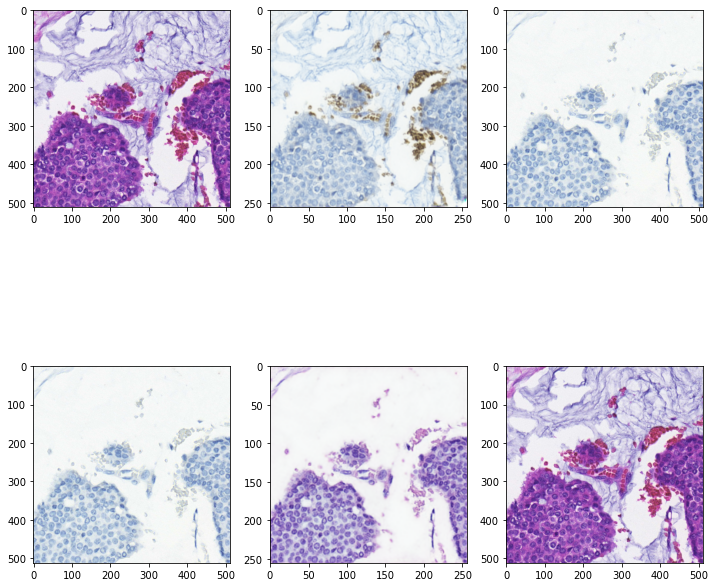

In [14]:
_, ax = plt.subplots(2, 3, figsize=(12, 12))
ax[0, 0].imshow(image_array)
ax[0, 1].imshow(target_predicted_image_array)
ax[0, 2].imshow(target_image_array)
ax[1, 0].imshow(target_image_array)
ax[1, 1].imshow(predicted_image_array)
ax[1, 2].imshow(image_array)

# Unused Code

In [23]:
image_array, target_image_array = train_data_loader[0]

In [24]:
source_array = image_array[0]
source_array = (source_array + 1) * 127.5
source_array = source_array.astype("uint8")

In [25]:
converted = generator_G(image_array)[0]
converted = np.array(converted)
converted = (converted + 1) * 127.5
converted = converted.astype("uint8")

In [26]:
temp_array = image_array[0]
temp_array = (temp_array + 1) * 127.5
temp_array = temp_array.astype("uint8")

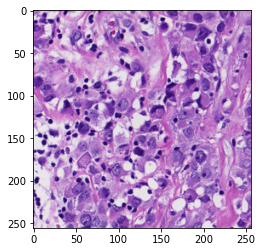

In [28]:
from matplotlib import pyplot as plt

plt.imshow(source_array)

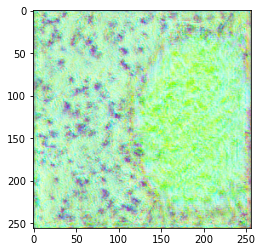

In [29]:
from matplotlib import pyplot as plt

plt.imshow(converted)

# Unused Code

In [ ]:
y_true = train_data_loader[0][0]
y_true = tf.convert_to_tensor(y_true)
one_array = np.ones((1,512,512,3))
one_diff_array = deepcopy(one_array)
one_diff_array[:,:,:,0] = 0
one_diff_array[:,:30,:30,1] = 0

one_array = tf.convert_to_tensor(one_array)
one_diff_array = tf.convert_to_tensor(one_diff_array)

In [ ]:
beta = 0.7
CHANNEL_WEIGHTED_AXIS = [1, 2]
y_true = one_array
y_pred = one_diff_array
smooth = K.epsilon()

alpha = 1 - beta
prevalence_per_channel = \
    K.mean((y_true + 1) / 2, axis=CHANNEL_WEIGHTED_AXIS)

tp = K.sum(y_true * y_pred, axis=CHANNEL_WEIGHTED_AXIS)
tn = K.sum((1 - y_true) * (1 - y_pred), axis=CHANNEL_WEIGHTED_AXIS)
fp = K.sum(y_pred, axis=CHANNEL_WEIGHTED_AXIS) - tp
fn = K.sum(y_true, axis=CHANNEL_WEIGHTED_AXIS) - tp

channel_weighted_dice_loss = \
    (tp + smooth) / (tp + alpha * fn + beta * fp + smooth) * \
    (smooth + prevalence_per_channel)

print(f"channel_weighted_dice: {channel_weighted_dice_loss}")
print(f"channel_weighted_dice_loss: {channel_weighted_dice_loss.shape}")

channel_weighted_dice_loss = K.mean(channel_weighted_dice_loss)

print(f"prevalence_per_channel_shape: {prevalence_per_channel.shape}")
print(f"true_positive_shape: {tp.shape}")
print(f"false_positive_shape: {tp.shape}")
print(f"false_negative_shape: {tn.shape}")
print(f"channel_weighted_dice: {channel_weighted_dice_loss}")


In [ ]:
from tensorflow.keras import backend as K

beta=0.7
CHANNEL_WEIGHTED_AXIS=[1,2]
smooth=K.epsilon()

alpha = 1 - beta

y_true = tf.constant(image_array)
y_pred = tf.constant(image_array)

y_true = (y_true + 1 + smooth) / 2
y_pred = (y_pred + 1 + smooth) / 2

prevalence_per_channel = K.mean(y_true, axis=CHANNEL_WEIGHTED_AXIS)

weight_per_channel = 1 / prevalence_per_channel
weight_per_channel_sum = K.sum(weight_per_channel, axis=-1)
weight_per_channel_sum = tf.expand_dims(weight_per_channel_sum, axis=-1)
weight_per_channel = weight_per_channel / weight_per_channel_sum

tp = K.sum(y_true * y_pred, axis=CHANNEL_WEIGHTED_AXIS)
fp = K.sum(y_pred, axis=CHANNEL_WEIGHTED_AXIS) - tp
fn = K.sum(y_true, axis=CHANNEL_WEIGHTED_AXIS) - tp

channel_weighted_dice_loss = (tp + smooth) / (tp + alpha * fn + beta * fp + smooth) * \
    (smooth + weight_per_channel)

print(channel_weighted_dice_loss)

channel_weighted_dice_loss = K.mean(channel_weighted_dice_loss)